### segment waveform into individual syllables using dynamic thresholding
- 

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.autonotebook import tqdm
import pandas as pd
from datetime import datetime

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [4]:
import warnings
warnings.filterwarnings(action='once')

In [5]:
from avgn.utils.audio import load_wav, read_wav
from avgn.signalprocessing.filtering import butter_bandpass_filter
from vocalseg.dynamic_thresholding import dynamic_threshold_segmentation
from vocalseg.dynamic_thresholding import plot_segmented_spec, plot_segmentations

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)


In [6]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir

In [7]:
from avgn.utils.hparams import HParams
from avgn.dataset import DataSet

In [8]:
DATASET_ID = 'katahira_white_munia'

### Load data in original format

In [9]:
# create a unique datetime identifier for the files output by this notebook
DT_ID = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
DT_ID

'2019-10-07_21-44-28'

### create dataset

In [15]:
hparams = HParams(
    n_fft = 4096,
    mel_lower_edge_hertz=500,
    mel_upper_edge_hertz=20000,
    butter_lowcut = 500,
    butter_highcut = 20000,
    ref_level_db = 20,
    min_level_db = -100,
    win_length_ms = 4,
    hop_length_ms = 1,
    n_jobs = -1,
    verbosity=1,
    nex = -1
)

In [16]:
# create a dataset object
dataset = DataSet(DATASET_ID, hparams = hparams)

/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/avgn/utils/json.py:64: ResourceWarning: unclosed file <_io.TextIOWrapper name='/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/processed/katahira_white_munia/2019-06-26_10-52-13/JSON/WM37_1.JSON' mode='r' encoding='UTF-8'>
  return json.load(open(json_loc), object_pairs_hook=OrderedDict)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    5.3s


[Parallel(n_jobs=-1)]: Done 129 out of 176 | elapsed:    5.5s remaining:    2.0s
[Parallel(n_jobs=-1)]: Done 176 out of 176 | elapsed:    5.5s finished


/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tensorflow/python/keras/backend.py:5605: ResourceWarning: unclosed file <_io.TextIOWrapper name='/home/AD/tsainbur/.keras/keras.json' mode='r' encoding='UTF-8'>
  _config = json.load(open(_config_path))
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 88 from C header, got 96 from PyObject
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tensorflow/python/ops/signal/util_ops.py:62: DeprecationWarning: fractions.gcd() is deprecated. Use math.gcd() instead.
  return ops.convert_to_tensor(fractions.gcd(const_a, const_b))


In [10]:
dataset.sample_json

OrderedDict([('datetime', '2016-08-25_00-00-00'),
             ('samplerate_hz', 250000),
             ('length_s', 180.682752),
             ('wav_loc',
              '/mnt/cube/Datasets/mouse_usv/VOC597/VOC597_VOC571_SONG_CMPA_8_25_2016_30_16.56.WAV'),
             ('age', '30'),
             ('FemaleMouse', 'VOC571'),
             ('call_type', 'SONG'),
             ('weight', '16.56'),
             ('indvs', OrderedDict([('VOC597', OrderedDict())]))])

OrderedDict([('species', 'Lonchura striata'),
             ('common_name', 'White rumped munia'),
             ('wav_loc', '/mnt/cube/Datasets/WhiteMunia/WM/WM44/35.WAV'),
             ('samplerate_hz', 44100),
             ('length_s', 6.4209297052154195),
             ('wav_num', '35'),
             ('indvs', OrderedDict([('WM44', OrderedDict())]))])

In [186]:
### segmentation parameters
n_fft=1024
hop_length_ms=2
win_length_ms=4
ref_level_db=20
pre=0.97
min_level_db=-60
min_level_db_floor = -20
db_delta = 5
silence_threshold = 0.05
min_silence_for_spec=0.5
max_vocal_for_spec=0.5,
min_syllable_length_s = 0.01
butter_min = 500
butter_max = 15000
spectral_range = [500, 15000]

In [187]:
import librosa

In [188]:
rate, data = load_wav(dataset.data_files['WM01_1'].data["wav_loc"])

In [189]:
data = data[:rate*15]

In [190]:
rate

48000

In [191]:
np.min(data), np.max(data)

(-0.35336304, 0.38519287)

In [192]:
data = data / np.max(np.abs(data))

In [193]:
# filter data
data = butter_bandpass_filter(data, butter_min, butter_max, rate)

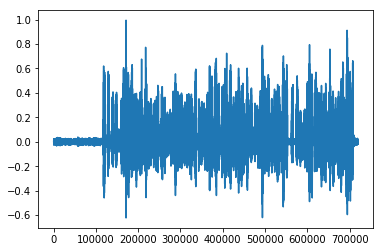

In [194]:
plt.plot(data)

In [195]:
# segment
results = dynamic_threshold_segmentation(
    data,
    rate,
    n_fft=n_fft,
    hop_length_ms=hop_length_ms,
    win_length_ms=win_length_ms,
    min_level_db_floor=min_level_db_floor,
    db_delta=db_delta,
    ref_level_db=ref_level_db,
    pre=pre,
    min_silence_for_spec=min_silence_for_spec,
    max_vocal_for_spec=max_vocal_for_spec,
    min_level_db=min_level_db,
    silence_threshold=silence_threshold,
    verbose=True,
    min_syllable_length_s=min_syllable_length_s,
    spectral_range=spectral_range,
)

longest silence 1.194
longest vocalization 0.1479999999999997


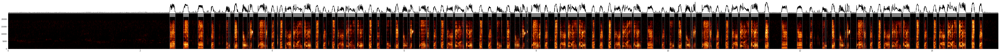

In [196]:
plot_segmentations(
    results["spec"],
    results["vocal_envelope"],
    results["onsets"],
    results["offsets"],
    hop_length_ms,
    rate,
    figsize=(100,5)
)
plt.show()

### segment and plot 
- for each json, load the wav file - segment the file into start and end times
- plot the segmentation
- add to the JSON 

In [197]:
import joblib

In [198]:
from avgn.utils.json import NoIndent, NoIndentEncoder

In [199]:
warnings.filterwarnings("ignore", message = "'tqdm_notebook' object has no attribute 'sp'")

def segment_spec_custom(key, df, save=False, plot=False):
    # load wav
    rate, data = load_wav(df.data["wav_loc"])
    # filter data
    data = butter_bandpass_filter(data, butter_min, butter_max, rate)

    # segment
    results = dynamic_threshold_segmentation(
        data,
        rate,
        n_fft=n_fft,
        hop_length_ms=hop_length_ms,
        win_length_ms=win_length_ms,
        min_level_db_floor=min_level_db_floor,
        db_delta=db_delta,
        ref_level_db=ref_level_db,
        pre=pre,
        min_silence_for_spec=min_silence_for_spec,
        max_vocal_for_spec=max_vocal_for_spec,
        min_level_db=min_level_db,
        silence_threshold=silence_threshold,
        verbose=True,
        min_syllable_length_s=min_syllable_length_s,
        spectral_range=spectral_range,
    )
    if results is None:
        return
    if plot:
        plot_segmentations(
            results["spec"],
            results["vocal_envelope"],
            results["onsets"],
            results["offsets"],
            hop_length_ms,
            rate,
            figsize=(100, 5)
        )
        plt.show()

    # save the results
    json_out = DATA_DIR / "processed" / (DATASET_ID + "_segmented") / DT_ID / "JSON" / (
        key + ".JSON"
    )

    json_dict = df.data.copy()

    json_dict["indvs"][list(df.data["indvs"].keys())[0]]["syllables"] = {
        "start_times": NoIndent(list(results["onsets"])),
        "end_times": NoIndent(list(results["offsets"])),
    }

    json_txt = json.dumps(json_dict, cls=NoIndentEncoder, indent=2)
    # save json
    if save:
        ensure_dir(json_out.as_posix())
        print(json_txt, file=open(json_out.as_posix(), "w"))

    print(json_txt)

    return results

In [200]:
indvs = np.array(['_'.join(list(i)) for i in dataset.json_indv])
np.unique(indvs)

array(['WM01', 'WM02', 'WM03', 'WM04', 'WM05', 'WM06', 'WM07', 'WM08',
       'WM09', 'WM10', 'WM11', 'WM12', 'WM13', 'WM14', 'WM15', 'WM16',
       'WM17', 'WM18', 'WM19', 'WM20', 'WM21', 'WM22', 'WM23', 'WM24',
       'WM25', 'WM26', 'WM27', 'WM28', 'WM29', 'WM30', 'WM31', 'WM32',
       'WM33', 'WM34', 'WM35', 'WM36', 'WM37', 'WM38', 'WM39', 'WM40',
       'WM41', 'WM42', 'WM43', 'WM44'], dtype='<U4')

WM01


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/signal/signaltools.py:1344: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out = out_full[ind]


/mnt/cube/tsainbur/Projects/github_repos/vocalization_segmentation/vocalseg/dynamic_thresholding.py:129: RuntimeWarning: invalid value encountered in sqrt
  vocal_envelope = np.max(spec, axis=0) * np.sqrt(np.mean(spec, axis=0))


longest silence 2.6200000000000045
longest vocalization 0.1540000000000532


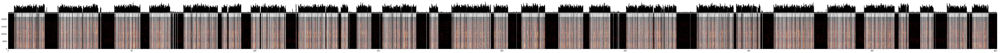

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM01/1.wav",
  "samplerate_hz": 48000,
  "length_s": 400.62108333333333,
  "wav_num": "1",
  "indvs": {
    "WM01": {
      "syllables": {
        "start_times": [2.448, 2.654, 2.874, 3.076, 3.304, 3.346, 3.43, 3.558, 3.656, 3.786, 3.9, 3.99, 4.078, 4.116, 4.196, 4.318, 4.486, 4.66, 4.772, 4.908, 4.99, 5.116, 5.16, 5.288, 5.466, 5.588, 5.734, 5.78, 5.872, 5.986, 6.084, 6.23, 6.346, 6.444, 6.554, 6.646, 6.77, 6.894, 6.938, 7.14, 7.274, 7.404, 7.442, 7.556, 7.68, 7.792, 7.862, 7.928, 8.04, 8.132, 8.278, 8.366, 8.48, 8.648, 8.846, 8.966, 9.092, 9.186, 9.304, 9.478, 9.684, 9.906, 10.026, 10.072, 10.156, 10.272, 10.354, 10.37, 10.516, 10.634, 10.728, 10.87, 10.966, 11.088, 11.254, 11.47, 11.716, 11.952, 12.148, 12.338, 12.38, 12.48, 12.598, 12.708, 12.854, 12.97, 13.058, 13.18, 13.268, 13.39, 13.56, 13.758, 13.878, 14.018, 14.108, 14.23, 14.406, 14.598, 14.716, 20.136, 20

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   30.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   30.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 4.748000000000019
longest vocalization 0.1839999999999975


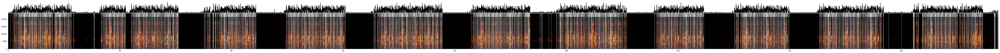

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM02/1.wav",
  "samplerate_hz": 48000,
  "length_s": 177.3405,
  "wav_num": "1",
  "indvs": {
    "WM02": {
      "syllables": {
        "start_times": [0.442, 0.868, 1.014, 1.156, 1.33, 1.54, 1.756, 1.824, 2.008, 2.024, 2.116, 2.148, 2.282, 2.348, 2.502, 2.642, 2.78, 2.894, 2.93, 2.952, 2.992, 3.038, 3.17, 3.334, 3.43, 3.666, 3.732, 3.85, 3.884, 4.038, 4.148, 4.246, 4.318, 4.428, 4.462, 4.618, 4.706, 4.746, 4.85, 4.962, 5.028, 5.15, 5.332, 5.466, 5.59, 5.724, 5.754, 5.788, 5.942, 6.084, 6.218, 6.288, 6.428, 6.54, 6.566, 6.68, 6.776, 6.826, 6.954, 7.114, 7.212, 7.43, 7.502, 7.618, 7.836, 7.978, 8.29, 8.418, 8.456, 8.544, 8.562, 8.604, 8.718, 8.79, 8.944, 9.092, 9.2, 9.236, 9.304, 9.36, 9.488, 9.666, 9.78, 10.018, 10.098, 10.214, 10.408, 10.55, 10.684, 10.822, 10.884, 11.054, 11.242, 11.716, 15.364, 15.382, 15.402, 16.724, 16.946, 17.106, 17.268, 17.408, 17.54, 17.61,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   12.1s remaining:    0.0s


longest silence 3.1359999999999957
longest vocalization 0.1980000000000004


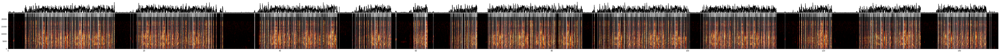

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM02/2.wav",
  "samplerate_hz": 48000,
  "length_s": 145.69333333333333,
  "wav_num": "2",
  "indvs": {
    "WM02": {
      "syllables": {
        "start_times": [0.82, 2.454, 2.566, 2.688, 2.938, 3.12, 3.26, 3.394, 3.598, 3.674, 3.904, 4.008, 4.142, 4.284, 4.412, 4.54, 4.6, 4.742, 4.882, 4.992, 5.028, 5.092, 5.142, 5.268, 5.426, 5.528, 5.754, 5.82, 5.934, 5.986, 6.032, 6.126, 6.238, 6.336, 6.398, 6.514, 6.704, 6.82, 6.93, 6.996, 7.112, 7.294, 7.424, 7.538, 7.64, 7.712, 7.818, 7.87, 7.914, 8.012, 8.124, 8.154, 8.286, 8.366, 8.604, 8.67, 8.786, 8.98, 9.12, 9.25, 9.376, 9.402, 9.448, 9.588, 9.74, 9.862, 9.926, 10.072, 10.214, 10.328, 10.428, 10.474, 10.604, 10.72, 10.764, 10.854, 10.866, 11.088, 11.154, 11.276, 11.304, 11.466, 11.616, 11.74, 11.846, 11.91, 12.064, 12.132, 12.168, 12.292, 12.436, 12.574, 12.638, 12.784, 12.926, 13.064, 13.182, 13.218, 13.284, 13.33, 13.

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   22.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   22.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 3.563999999999993
longest vocalization 0.3200000000000003


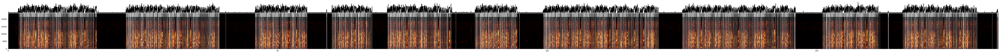

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM03/3.wav",
  "samplerate_hz": 48000,
  "length_s": 183.65747916666666,
  "wav_num": "3",
  "indvs": {
    "WM03": {
      "syllables": {
        "start_times": [0.014, 2.014, 2.232, 2.286, 2.39, 2.474, 2.624, 2.772, 2.944, 3.054, 3.192, 3.352, 3.418, 3.524, 3.676, 3.788, 3.832, 3.96, 4.174, 4.23, 4.318, 4.492, 4.594, 4.742, 4.894, 5.008, 5.298, 5.452, 5.556, 5.63, 5.742, 5.896, 6.06, 6.134, 6.236, 6.39, 6.504, 6.744, 6.814, 6.884, 6.994, 7.146, 7.264, 7.46, 7.742, 7.95, 8.146, 8.312, 8.352, 8.524, 8.67, 8.848, 8.952, 8.97, 9.102, 9.268, 9.34, 9.452, 9.606, 9.72, 9.938, 10.23, 10.458, 10.666, 10.898, 11.124, 11.282, 11.43, 11.53, 11.604, 11.712, 11.858, 12.04, 12.11, 12.22, 12.372, 12.49, 12.686, 13.002, 13.178, 13.336, 13.438, 13.512, 13.624, 13.78, 13.95, 14.07, 14.422, 14.604, 14.764, 14.87, 15.07, 15.268, 15.482, 15.718, 15.874, 16.146, 21.856, 22.0, 22.074, 22.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   11.1s remaining:    0.0s


longest silence 2.5800000000000054
longest vocalization 0.2680000000000007


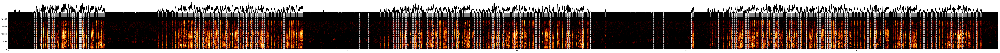

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM03/2.wav",
  "samplerate_hz": 48000,
  "length_s": 58.4029375,
  "wav_num": "2",
  "indvs": {
    "WM03": {
      "syllables": {
        "start_times": [1.51, 1.664, 1.86, 1.958, 2.03, 2.146, 2.224, 2.29, 2.436, 2.5, 2.612, 2.76, 2.876, 3.11, 3.18, 3.25, 3.356, 3.506, 3.62, 3.79, 4.016, 4.166, 4.21, 4.266, 4.336, 4.44, 4.584, 4.738, 4.854, 5.158, 5.318, 5.418, 5.49, 5.604, 8.834, 9.08, 9.292, 9.684, 9.866, 10.032, 10.208, 10.31, 10.438, 10.452, 10.624, 10.69, 10.796, 10.946, 11.06, 11.218, 11.282, 11.358, 11.412, 11.53, 11.68, 11.794, 11.96, 12.208, 12.49, 12.636, 12.738, 12.808, 12.912, 13.216, 13.336, 13.68, 13.76, 13.81, 13.962, 14.064, 14.138, 14.252, 14.394, 14.492, 14.548, 14.614, 14.726, 14.874, 15.002, 15.212, 15.49, 15.694, 15.804, 15.888, 16.09, 16.24, 16.394, 16.496, 16.568, 16.682, 16.788, 16.99, 17.082, 17.118, 20.708, 21.252, 21.934, 21.948, 22.158, 2

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   15.0s remaining:    0.0s


longest silence 2.26400000000001
longest vocalization 0.3440000000000225


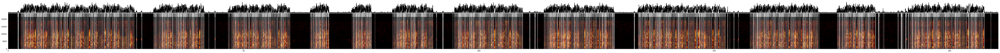

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM03/1.wav",
  "samplerate_hz": 48000,
  "length_s": 210.316625,
  "wav_num": "1",
  "indvs": {
    "WM03": {
      "syllables": {
        "start_times": [2.056, 2.1, 2.132, 2.176, 2.192, 2.728, 2.936, 3.148, 3.284, 3.416, 3.52, 3.59, 3.696, 3.836, 4.0, 4.066, 4.174, 4.322, 4.44, 4.664, 4.74, 4.808, 4.916, 5.07, 5.186, 5.356, 5.624, 5.958, 6.114, 6.22, 6.312, 6.41, 6.556, 6.718, 6.792, 6.898, 7.05, 7.168, 7.41, 7.488, 7.556, 7.672, 7.822, 7.942, 8.122, 8.396, 8.61, 8.856, 9.072, 9.12, 9.204, 9.352, 9.456, 9.526, 9.64, 9.79, 9.954, 10.034, 10.14, 10.292, 10.412, 10.638, 10.914, 11.084, 11.182, 11.29, 11.424, 11.734, 11.884, 11.986, 12.056, 12.166, 12.322, 12.486, 12.568, 12.588, 12.612, 12.996, 13.236, 13.39, 13.418, 13.628, 13.834, 14.07, 14.274, 14.354, 14.388, 14.42, 14.568, 14.672, 14.75, 14.856, 15.0, 15.168, 15.246, 15.352, 15.508, 15.622, 15.844, 16.11, 16.302,

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   27.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   27.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.514000000000003
longest vocalization 0.21399999999999864


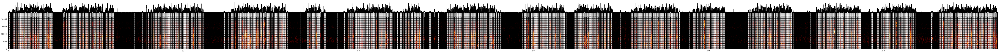

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM04/1.wav",
  "samplerate_hz": 48000,
  "length_s": 282.91883333333334,
  "wav_num": "1",
  "indvs": {
    "WM04": {
      "syllables": {
        "start_times": [0.364, 0.86, 1.294, 1.324, 1.524, 1.776, 2.008, 2.168, 2.378, 2.562, 2.718, 2.846, 3.026, 3.202, 3.348, 3.504, 3.578, 3.708, 3.83, 3.924, 4.064, 4.236, 4.386, 4.476, 4.664, 4.79, 4.818, 4.914, 4.986, 5.036, 5.094, 5.178, 5.268, 5.402, 5.582, 5.738, 5.852, 6.028, 6.15, 6.202, 6.272, 6.402, 6.45, 6.536, 6.716, 6.756, 6.948, 7.09, 7.232, 7.414, 7.48, 7.554, 7.612, 7.75, 7.84, 7.97, 8.042, 8.188, 8.316, 8.414, 8.606, 8.79, 8.946, 9.09, 9.206, 9.258, 9.328, 9.454, 9.47, 9.508, 9.592, 9.686, 9.832, 10.022, 10.172, 10.272, 10.456, 10.648, 10.804, 10.954, 11.078, 11.13, 11.196, 11.326, 11.38, 11.48, 11.57, 11.72, 11.798, 11.946, 12.082, 12.196, 12.374, 12.41, 12.474, 12.51, 12.89, 15.41, 15.582, 15.796, 16.046, 16.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   19.5s remaining:    0.0s


longest silence 1.8379999999999939
longest vocalization 0.2540000000000049


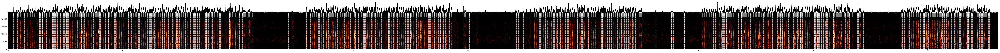

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM04/2.wav",
  "samplerate_hz": 48000,
  "length_s": 86.15014583333334,
  "wav_num": "2",
  "indvs": {
    "WM04": {
      "syllables": {
        "start_times": [0.432, 0.728, 0.886, 1.05, 1.204, 1.382, 1.61, 1.776, 1.916, 2.102, 2.272, 2.406, 2.562, 2.58, 2.642, 2.684, 2.714, 2.726, 2.744, 2.774, 2.824, 2.9, 2.98, 2.994, 3.13, 3.298, 3.438, 3.532, 3.702, 3.842, 3.88, 3.942, 4.012, 4.044, 4.07, 4.126, 4.188, 4.29, 4.416, 4.488, 4.558, 4.664, 4.79, 4.842, 4.906, 5.032, 5.074, 5.156, 5.262, 5.394, 5.574, 5.72, 5.828, 6.012, 6.146, 6.18, 6.26, 6.33, 6.384, 6.442, 6.514, 6.614, 6.76, 6.946, 7.112, 7.228, 7.416, 7.542, 7.592, 7.668, 7.74, 7.796, 7.852, 7.936, 8.028, 8.154, 8.23, 8.412, 8.588, 8.662, 8.734, 8.794, 8.846, 8.916, 9.018, 9.17, 9.254, 9.364, 9.402, 9.524, 9.63, 9.816, 10.002, 10.166, 10.31, 10.44, 10.482, 10.558, 10.634, 10.69, 10.75, 10.82, 10.924, 11.064, 11

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   25.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   25.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 4.972000000000037
longest vocalization 0.2419999999999618


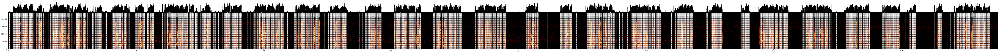

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM05/1.wav",
  "samplerate_hz": 48000,
  "length_s": 388.07175,
  "wav_num": "1",
  "indvs": {
    "WM05": {
      "syllables": {
        "start_times": [0.42, 0.504, 0.522, 0.554, 1.034, 1.056, 1.42, 1.532, 2.064, 2.14, 2.236, 2.468, 2.518, 2.778, 3.014, 3.204, 3.24, 3.31, 3.328, 3.346, 3.384, 3.522, 3.578, 3.6, 3.626, 3.73, 3.792, 3.904, 4.048, 4.164, 4.304, 4.404, 4.496, 4.572, 4.636, 4.752, 4.894, 5.006, 5.256, 5.444, 5.59, 5.746, 5.824, 5.854, 5.966, 6.036, 6.146, 6.294, 6.408, 6.572, 6.672, 6.75, 6.848, 6.914, 7.028, 7.18, 7.294, 7.448, 7.478, 7.552, 7.812, 7.988, 8.128, 8.216, 8.23, 8.248, 8.356, 8.42, 8.534, 8.684, 8.712, 8.798, 8.958, 9.062, 9.158, 9.238, 9.306, 9.422, 9.576, 9.692, 9.99, 10.244, 10.522, 11.062, 11.456, 11.584, 11.696, 11.77, 11.836, 11.864, 11.986, 12.058, 12.076, 12.094, 12.2, 12.27, 12.38, 12.528, 12.642, 12.802, 12.904, 13.004, 13.088, 1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   26.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   26.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.693999999999999
longest vocalization 0.3680000000000003


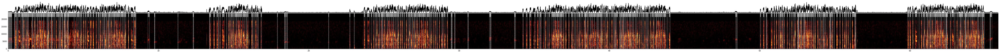

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM06/1.wav",
  "samplerate_hz": 48000,
  "length_s": 65.8679375,
  "wav_num": "1",
  "indvs": {
    "WM06": {
      "syllables": {
        "start_times": [0.002, 0.024, 0.042, 0.084, 0.114, 0.148, 0.178, 0.228, 0.416, 0.448, 0.462, 0.548, 0.618, 0.66, 0.862, 0.938, 0.988, 1.02, 1.076, 1.148, 1.228, 1.312, 1.334, 1.608, 1.622, 1.75, 1.838, 1.95, 1.99, 2.102, 2.216, 2.366, 2.382, 2.596, 2.65, 2.666, 2.77, 2.882, 2.898, 2.922, 3.058, 3.194, 3.318, 3.402, 3.49, 3.514, 3.614, 3.702, 3.748, 3.778, 3.792, 3.808, 3.918, 3.98, 4.0, 4.39, 4.56, 4.66, 4.792, 4.87, 5.006, 5.13, 5.258, 5.458, 5.63, 5.838, 5.98, 6.026, 6.114, 6.23, 6.312, 6.406, 6.42, 6.52, 6.616, 6.692, 6.712, 6.726, 6.834, 6.922, 7.038, 7.074, 7.194, 7.316, 7.484, 7.59, 7.712, 7.786, 7.98, 8.172, 8.354, 8.388, 8.494, 9.288, 9.728, 9.742, 11.29, 12.288, 12.33, 13.392, 13.416, 13.664, 13.872, 13.988, 14.08, 14.238

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.6s remaining:    0.0s


longest silence 2.1799999999999997
longest vocalization 0.36799999999999944


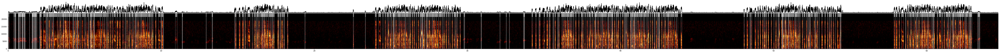

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM06/3.wav",
  "samplerate_hz": 48000,
  "length_s": 64.6763125,
  "wav_num": "3",
  "indvs": {
    "WM06": {
      "syllables": {
        "start_times": [0.03, 0.044, 0.374, 0.39, 0.46, 0.474, 0.494, 0.662, 0.682, 0.696, 0.726, 0.778, 0.82, 0.902, 0.942, 0.968, 0.982, 1.048, 1.072, 1.102, 1.39, 1.552, 1.568, 1.592, 1.618, 1.66, 1.678, 1.72, 1.75, 1.786, 1.814, 1.864, 2.052, 2.084, 2.108, 2.296, 2.498, 2.514, 2.574, 2.656, 2.712, 2.784, 2.864, 2.948, 2.97, 3.258, 3.386, 3.474, 3.586, 3.626, 3.738, 3.852, 4.002, 4.018, 4.232, 4.286, 4.302, 4.406, 4.442, 4.518, 4.534, 4.558, 4.694, 4.83, 4.954, 5.038, 5.15, 5.25, 5.338, 5.384, 5.414, 5.428, 5.444, 5.554, 5.616, 5.636, 6.026, 6.196, 6.296, 6.428, 6.506, 6.642, 6.768, 6.894, 7.094, 7.266, 7.476, 7.616, 7.67, 7.75, 7.866, 7.948, 8.056, 8.156, 8.252, 8.328, 8.348, 8.364, 8.47, 8.558, 8.674, 8.71, 8.83, 8.952, 9.12, 9.226, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    9.7s remaining:    0.0s


longest silence 1.911999999999992
longest vocalization 0.3100000000000023


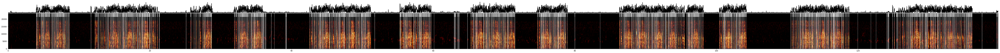

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM06/2.wav",
  "samplerate_hz": 48000,
  "length_s": 139.76535416666667,
  "wav_num": "2",
  "indvs": {
    "WM06": {
      "syllables": {
        "start_times": [3.956, 4.052, 4.162, 4.374, 4.626, 4.714, 4.776, 4.876, 4.964, 4.98, 5.086, 5.19, 5.298, 5.436, 5.562, 5.718, 5.806, 6.046, 6.19, 6.22, 6.314, 6.436, 6.514, 6.61, 6.694, 6.788, 6.866, 6.88, 7.0, 7.086, 7.192, 7.34, 7.456, 7.618, 7.706, 7.828, 7.9, 8.024, 8.138, 8.264, 8.398, 8.512, 8.592, 11.682, 12.252, 12.436, 12.674, 12.716, 12.826, 13.04, 13.208, 13.408, 13.574, 13.794, 13.926, 14.04, 14.078, 14.13, 14.218, 14.414, 14.508, 14.522, 14.626, 14.704, 14.816, 14.854, 14.96, 15.078, 15.24, 15.346, 15.446, 15.502, 15.516, 15.652, 15.772, 15.89, 16.03, 16.072, 16.146, 16.226, 16.276, 16.314, 16.326, 16.41, 16.506, 16.598, 16.612, 16.72, 16.828, 16.926, 17.078, 17.206, 17.364, 17.458, 17.58, 17.662, 17.792, 17.9

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   18.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   18.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.3679999999999986
longest vocalization 0.2400000000000091


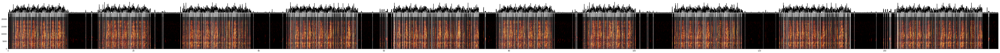

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM07/2.wav",
  "samplerate_hz": 48000,
  "length_s": 158.11372916666667,
  "wav_num": "2",
  "indvs": {
    "WM07": {
      "syllables": {
        "start_times": [0.214, 0.468, 0.624, 0.776, 0.814, 0.938, 1.086, 1.168, 1.224, 1.336, 1.48, 1.592, 1.74, 1.902, 2.006, 2.07, 2.206, 2.27, 2.382, 2.528, 2.642, 2.786, 2.964, 3.084, 3.146, 3.29, 3.426, 3.548, 3.606, 3.722, 3.786, 3.898, 4.046, 4.16, 4.308, 4.502, 4.628, 4.69, 4.838, 4.984, 5.128, 5.282, 5.364, 5.426, 5.538, 5.69, 5.806, 5.958, 6.084, 6.148, 6.284, 6.352, 6.51, 6.674, 6.754, 6.816, 6.934, 7.084, 7.204, 7.354, 7.554, 7.6, 7.626, 7.794, 7.856, 7.974, 8.124, 8.242, 8.398, 8.594, 8.74, 8.808, 8.992, 9.222, 9.496, 12.392, 13.298, 13.372, 14.352, 14.542, 14.638, 14.786, 15.028, 15.116, 15.168, 15.378, 15.508, 15.636, 15.702, 15.814, 15.956, 16.072, 16.218, 16.386, 16.464, 16.482, 16.684, 16.746, 16.864, 17.014, 17.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    9.6s remaining:    0.0s


longest silence 2.6499999999999773
longest vocalization 0.25200000000000244


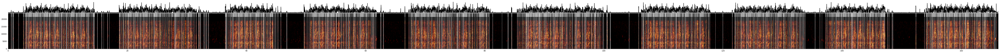

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM07/1.wav",
  "samplerate_hz": 48000,
  "length_s": 166.17329166666667,
  "wav_num": "1",
  "indvs": {
    "WM07": {
      "syllables": {
        "start_times": [0.48, 0.524, 0.786, 0.798, 0.818, 0.848, 1.74, 2.54, 2.6, 2.812, 2.982, 3.058, 3.124, 3.298, 3.43, 3.486, 3.598, 3.742, 3.856, 3.998, 4.172, 4.276, 4.34, 4.474, 4.536, 4.644, 4.796, 4.918, 5.06, 5.234, 5.364, 5.428, 5.568, 5.702, 5.882, 6.012, 6.076, 6.194, 6.342, 6.466, 6.564, 6.592, 6.806, 6.924, 6.988, 7.138, 7.282, 7.476, 7.616, 7.76, 7.842, 7.91, 8.018, 8.168, 8.284, 8.434, 8.624, 8.696, 8.876, 8.942, 9.024, 9.226, 9.402, 9.58, 9.76, 9.778, 9.834, 9.932, 10.092, 10.268, 10.428, 10.508, 10.572, 10.686, 10.836, 10.954, 11.106, 11.314, 11.44, 11.508, 11.66, 11.808, 11.964, 12.114, 12.21, 12.278, 12.396, 12.548, 12.67, 12.826, 13.058, 13.216, 13.284, 13.428, 13.464, 13.49, 13.688, 13.936, 14.16, 14.306, 14

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   20.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   20.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.655999999999999
longest vocalization 0.2559999999999718


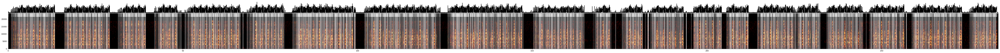

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM08/1.wav",
  "samplerate_hz": 48000,
  "length_s": 283.34745833333335,
  "wav_num": "1",
  "indvs": {
    "WM08": {
      "syllables": {
        "start_times": [0.004, 0.036, 0.87, 1.108, 1.314, 1.486, 1.768, 1.94, 2.118, 2.294, 2.496, 2.672, 2.832, 2.93, 3.026, 3.072, 3.09, 3.16, 3.296, 3.408, 3.432, 3.516, 3.712, 3.79, 3.892, 3.978, 4.066, 4.268, 4.358, 4.448, 4.538, 4.64, 4.738, 4.776, 4.806, 4.876, 5.022, 5.18, 5.25, 5.444, 5.53, 5.628, 5.802, 5.892, 6.05, 6.2, 6.292, 6.384, 6.476, 6.578, 6.674, 6.712, 6.742, 6.812, 6.904, 6.952, 7.072, 7.114, 7.18, 7.368, 7.446, 7.55, 7.688, 7.778, 7.978, 8.072, 8.164, 8.264, 8.362, 8.402, 8.43, 8.5, 8.646, 8.772, 8.868, 9.064, 9.146, 9.254, 9.426, 9.512, 9.686, 9.83, 9.93, 10.018, 10.108, 10.204, 10.308, 10.358, 10.402, 10.448, 10.474, 10.544, 10.686, 10.812, 10.838, 10.85, 10.91, 11.11, 11.186, 11.294, 11.45, 11.54, 11.732, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   24.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   24.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.9599999999999937
longest vocalization 0.2740000000000009


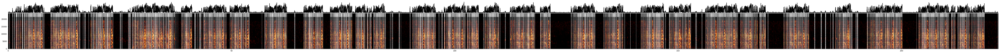

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM09/1.wav",
  "samplerate_hz": 48000,
  "length_s": 221.65727083333334,
  "wav_num": "1",
  "indvs": {
    "WM09": {
      "syllables": {
        "start_times": [0.272, 0.312, 0.962, 1.012, 1.334, 1.362, 1.386, 1.408, 1.664, 1.7, 1.824, 1.886, 1.938, 2.178, 2.19, 2.402, 2.626, 2.804, 3.144, 3.18, 3.204, 3.236, 3.258, 3.324, 3.568, 3.646, 3.68, 3.8, 3.97, 4.156, 4.198, 4.368, 4.524, 4.62, 4.72, 4.822, 4.934, 5.034, 5.1, 5.202, 5.34, 5.484, 5.582, 5.792, 5.906, 6.004, 6.132, 6.226, 6.376, 6.522, 6.642, 6.744, 6.812, 6.916, 7.052, 7.174, 7.198, 7.294, 7.498, 7.618, 7.73, 7.948, 7.996, 8.016, 9.522, 9.608, 9.684, 9.884, 10.11, 10.202, 10.272, 10.42, 10.58, 10.678, 10.784, 10.898, 10.996, 11.158, 11.3, 11.426, 11.542, 11.754, 11.87, 11.974, 12.108, 12.2, 12.346, 12.454, 12.672, 12.774, 12.888, 12.944, 13.084, 13.174, 13.224, 13.334, 13.548, 13.662, 13.774, 13.938, 14.026

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   14.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   14.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.8260000000000005
longest vocalization 0.35600000000000875


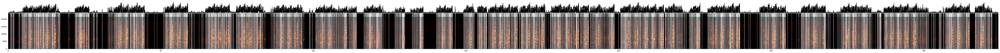

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM10/1.wav",
  "samplerate_hz": 48000,
  "length_s": 324.3779583333333,
  "wav_num": "1",
  "indvs": {
    "WM10": {
      "syllables": {
        "start_times": [0.728, 0.748, 0.97, 1.09, 1.108, 1.46, 1.596, 1.632, 1.754, 1.79, 1.968, 3.53, 3.604, 3.658, 4.156, 4.464, 4.604, 4.728, 4.8, 4.816, 4.936, 4.998, 5.118, 5.312, 5.384, 5.482, 5.55, 5.678, 5.766, 5.85, 6.024, 6.19, 6.388, 6.502, 6.588, 6.738, 6.834, 6.926, 7.028, 7.138, 7.2, 7.266, 7.328, 7.404, 7.54, 7.732, 7.808, 7.91, 8.172, 8.322, 8.512, 8.618, 8.68, 8.73, 8.802, 8.9, 9.09, 9.176, 9.262, 9.338, 9.434, 9.61, 9.706, 9.798, 9.9, 9.936, 9.962, 10.01, 10.07, 10.198, 10.27, 10.416, 10.608, 10.686, 10.788, 10.966, 11.058, 11.246, 11.314, 11.416, 11.49, 11.508, 11.574, 11.588, 11.674, 11.768, 11.94, 12.124, 12.22, 12.312, 12.418, 12.59, 12.626, 12.662, 12.72, 12.81, 12.844, 12.866, 12.94, 13.134, 13.312, 13.504, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   24.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   24.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 3.919999999999959
longest vocalization 0.45400000000000773


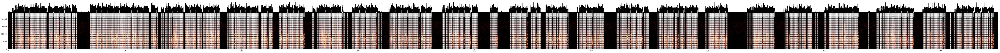

{
  "species": "Lonchura striata",
  "common_name": "White rumped munia",
  "wav_loc": "/mnt/cube/Datasets/WhiteMunia/WM/WM11/1.wav",
  "samplerate_hz": 48000,
  "length_s": 424.591625,
  "wav_num": "1",
  "indvs": {
    "WM11": {
      "syllables": {
        "start_times": [0.002, 0.216, 0.29, 0.306, 0.326, 0.416, 1.156, 1.306, 1.786, 1.882, 2.35, 2.568, 2.88, 3.052, 3.288, 3.47, 3.69, 3.782, 3.848, 4.096, 4.264, 4.382, 4.448, 4.516, 4.598, 4.68, 4.762, 4.844, 4.926, 5.008, 5.092, 5.176, 5.26, 5.346, 5.438, 5.536, 5.63, 5.724, 5.816, 5.908, 6.012, 6.056, 6.188, 6.304, 6.414, 6.614, 7.092, 7.21, 7.434, 7.57, 7.64, 7.726, 7.81, 7.902, 8.0, 8.094, 8.19, 8.28, 8.386, 8.43, 8.558, 8.686, 8.786, 8.992, 9.322, 9.4, 9.43, 9.598, 9.744, 9.924, 9.994, 10.08, 10.164, 10.258, 10.362, 10.456, 10.55, 10.642, 10.75, 10.8, 10.928, 11.056, 11.162, 11.356, 11.674, 11.794, 11.904, 11.964, 12.064, 12.148, 12.224, 12.31, 12.412, 12.51, 12.606, 12.7, 12.798, 12.886, 12.992, 13.042, 13.17, 13.3, 13.402, 13.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   34.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   34.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 3.3319999999999936
longest vocalization 0.35200000000000387


KeyboardInterrupt: 

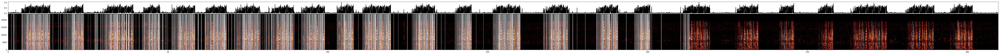

In [201]:
nex = 3
for indv in tqdm(np.unique(indvs), desc="individuals"):
    print(indv)
    indv_keys = np.array(list(dataset.data_files.keys()))[indvs == indv][:nex]

    joblib.Parallel(n_jobs=1, verbose=11)(
            joblib.delayed(segment_spec_custom)(key, dataset.data_files[key], plot=True) 
                 for key in tqdm(indv_keys, desc="files", leave=False)
        )

### Generate for full dataset

In [203]:
nex = -1
for indv in tqdm(np.unique(indvs), desc="individuals"):
    print(indv)
    indv_keys = np.array(list(dataset.data_files.keys()))[indvs == indv]

    joblib.Parallel(n_jobs=-1, verbose=11)(
            joblib.delayed(segment_spec_custom)(key, dataset.data_files[key], save=True) 
                 for key in tqdm(indv_keys, desc="files", leave=False)
        )

WM01


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM02


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   16.4s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    7.0s


WM03


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    8.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    8.1s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.6s


WM04


[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    8.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    8.3s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.2s


WM05


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   11.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   11.1s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM06


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   15.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    6.7s


WM07


[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    8.8s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    8.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    7.2s


WM08


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    7.5s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    7.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM09


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   11.4s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   11.4s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM10


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    9.4s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.4s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM11


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   13.8s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   13.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM12


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   16.6s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   16.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM13


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   14.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM14


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   11.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM15


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   11.6s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   11.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    6.5s


WM16


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    6.8s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    6.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM17


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   14.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM18


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    7.5s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    7.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM19


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    6.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   2 out of  22 | elapsed:    0.5s remaining:    5.5s
[Parallel(n_jobs=-1)]: Done   5 out of  22 | elapsed:    0.6s remaining:    2.2s
[Parallel(n_jobs=-1)]: Done   8 out of  22 | elapsed:    0.7s remaining:    1.3s
[Parallel(n_jobs=-1)]: Done  11 out of  22 | elapsed:    0.8s remaining:    0.8s
[Parallel(n_jobs=-1)]: Done  14 out of  22 | elapsed:    0.8s remaining:    0.5s
[Parallel(n_jobs=-1)]: Done  17 out of  22 | elapsed:    0.9s remaining:    0.3s
[Parallel(n_jobs=-1)]: Done  20 out of  22 | elapsed:    0.9s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  22 out of  22 | elapsed:    0.9s finished


WM20


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM21


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    9.5s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM22


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   12.6s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   12.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM23


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    4.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM24


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    9.9s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   2 out of  11 | elapsed:    0.5s remaining:    2.2s
[Parallel(n_jobs=-1)]: Done   4 out of  11 | elapsed:    0.8s remaining:    1.4s
[Parallel(n_jobs=-1)]: Done   6 out of  11 | elapsed:    0.8s remaining:    0.7s
[Parallel(n_jobs=-1)]: Done   8 out of  11 | elapsed:    0.9s remaining:    0.3s


WM25


[Parallel(n_jobs=-1)]: Done  11 out of  11 | elapsed:    1.4s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   3 out of  16 | elapsed:    0.3s remaining:    1.4s
[Parallel(n_jobs=-1)]: Done   5 out of  16 | elapsed:    0.4s remaining:    1.0s
[Parallel(n_jobs=-1)]: Done   7 out of  16 | elapsed:    0.5s remaining:    0.7s
[Parallel(n_jobs=-1)]: Done   9 out of  16 | elapsed:    0.7s remaining:    0.5s
[Parallel(n_jobs=-1)]: Done  11 out of  16 | elapsed:    0.7s remaining:    0.3s
[Parallel(n_jobs=-1)]: Done  13 out of  16 | elapsed:    0.7s remaining:    0.2s


WM26


[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:    1.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    3.4s remaining:    5.0s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:    4.2s remaining:    2.8s


WM27


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.9s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM28


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:  1.1min finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.2s


WM29


[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   15.9s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   15.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   2 out of   4 | elapsed:    3.0s remaining:    3.0s


WM30


[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    9.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    9.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.7s


WM31


[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    8.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    8.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    1.4s remaining:    2.1s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:    1.6s remaining:    1.1s


WM32


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done   2 out of   4 | elapsed:    1.5s remaining:    1.5s


WM33


[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   31.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   31.7s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done   2 out of   9 | elapsed:    1.8s remaining:    6.5s
[Parallel(n_jobs=-1)]: Done   3 out of   9 | elapsed:    2.1s remaining:    4.2s
[Parallel(n_jobs=-1)]: Done   4 out of   9 | elapsed:    2.4s remaining:    3.0s
[Parallel(n_jobs=-1)]: Done   5 out of   9 | elapsed:    2.5s remaining:    2.0s
[Parallel(n_jobs=-1)]: Done   6 out of   9 | elapsed:    2.6s remaining:    1.3s
[Parallel(n_jobs=-1)]: Done   7 out of   9 | elapsed:    2.8s remaining:    0.8s


WM34


[Parallel(n_jobs=-1)]: Done   9 out of   9 | elapsed:    4.5s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   9 out of   9 | elapsed:    4.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done   2 out of   4 | elapsed:    1.5s remaining:    1.5s


WM35


[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    4.4s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    4.4s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    0.7s remaining:    1.0s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:    1.4s remaining:    0.9s


WM36


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    5.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    5.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.5s


WM37


[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   33.9s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   33.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done   2 out of   4 | elapsed:    2.3s remaining:    2.3s


WM38


[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    5.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    5.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.6s


WM39


[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   35.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   35.0s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.5s


WM40


[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   10.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   10.2s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM41


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:  2.5min finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM42


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   23.3s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   23.3s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM43


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   11.8s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   11.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


WM44


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    8.7s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   3 out of  38 | elapsed:    0.5s remaining:    5.9s
[Parallel(n_jobs=-1)]: Done   7 out of  38 | elapsed:    0.8s remaining:    3.6s
[Parallel(n_jobs=-1)]: Done  11 out of  38 | elapsed:    1.0s remaining:    2.4s
[Parallel(n_jobs=-1)]: Done  15 out of  38 | elapsed:    1.2s remaining:    1.9s
[Parallel(n_jobs=-1)]: Done  19 out of  38 | elapsed:    1.4s remaining:    1.4s
[Parallel(n_jobs=-1)]: Done  23 out of  38 | elapsed:    1.4s remaining:    0.9s
[Parallel(n_jobs=-1)]: Done  27 out of  38 | elapsed:    1.5s remaining:    0.6s
[Parallel(n_jobs=-1)]: Done  31 out of  38 | elapsed:    1.6s remaining:    0.4s
[Parallel(n_jobs=-1)]: Done  35 out of  38 | elapsed:    1.7s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  38 out of  38 | elapsed:    1.9s finished
